Copyright (c) 2020 ARS Computer & Consulting GmbH

This program and the accompanying materials are made
available under the terms of the Eclipse Public License 2.0
which is available at https://www.eclipse.org/legal/epl-2.0/

SPDX-License-Identifier: EPL-2.0

In [6]:
!pip install opencv-python

In [1]:
# imports

import numpy as np
import argparse
import cv2
import scipy
from sklearn import preprocessing
from sklearn import svm

In [2]:
from matplotlib import pyplot as plt
import os

def loadImagesAsOpencv(directory, extension = "bmp"):
    images = []
    names = []
    
    for filename in os.listdir(directory):
        processedFilename = filename.lower()
        
        if processedFilename.endswith(extension): 
            images.append(cv2.imread(os.path.join(directory, filename)))
            names.append(processedFilename)
            
    return images, names
    
def showOpenCVImages(openCVImages, cols = 1, titles = None):
    """Display a list of images in a single figure with matplotlib.
    
    Parameters
    ---------
    images: List of np.arrays compatible with plt.imshow.
    
    cols (Default = 1): Number of columns in figure (number of rows is 
                        set to np.ceil(n_images/float(cols))).
    
    titles: List of titles corresponding to each image. Must have
            the same length as titles.
            
    Modified from: https://gist.github.com/soply/f3eec2e79c165e39c9d540e916142ae1
    """
    assert((titles is None) or (len(openCVImages) == len(titles)) and isinstance(openCVImages, list))
    
    n_images = len(openCVImages)
    if titles is None: titles = ['Image (%d)' % i for i in range(1,n_images + 1)]
        
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(openCVImages, titles)):
        a = fig.add_subplot(cols, np.ceil(n_images/float(cols)), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        a.set_title(title)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

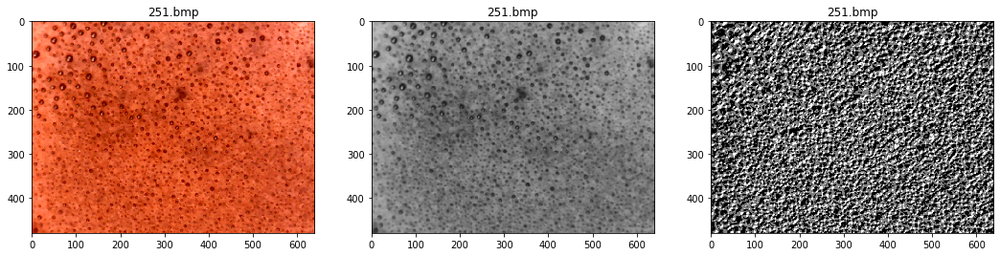

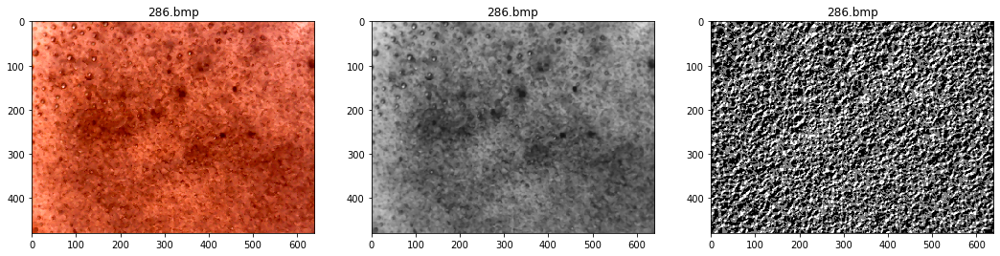

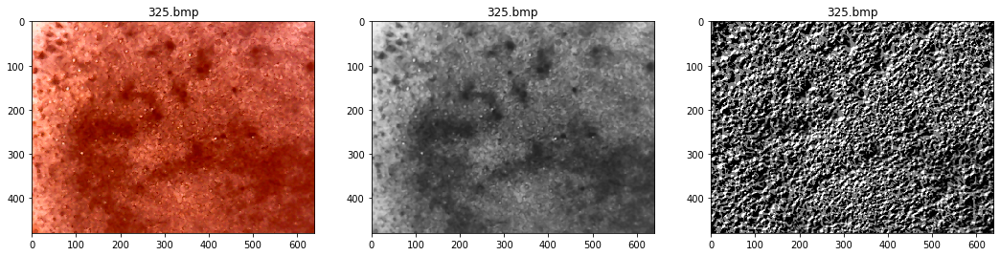

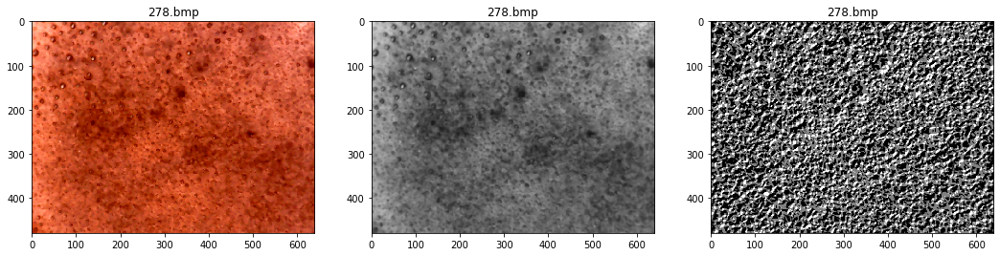

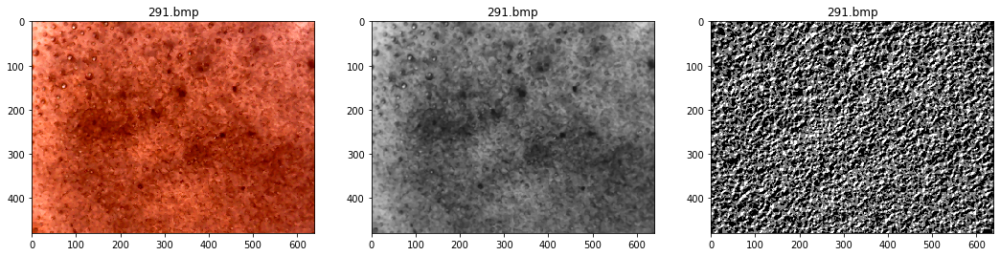

...

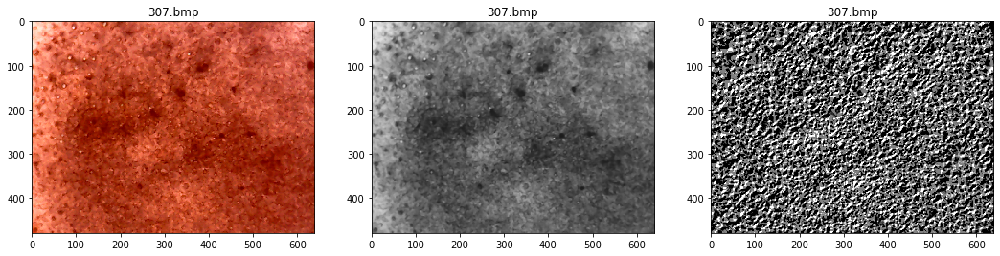

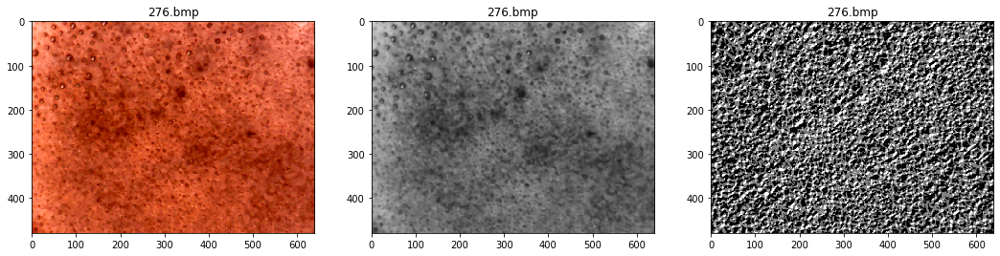

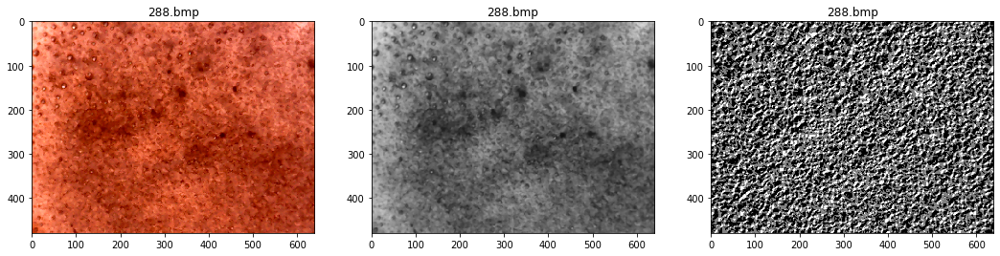

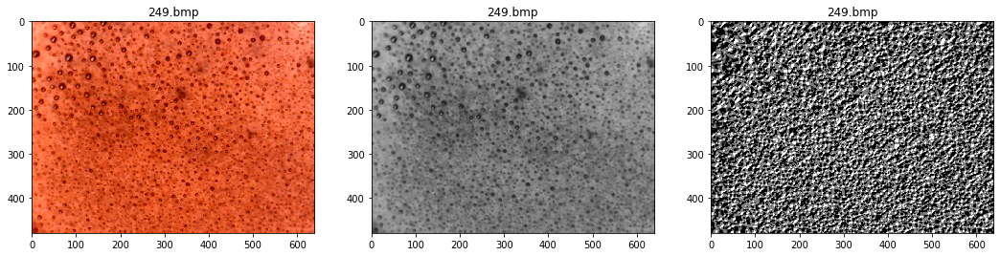

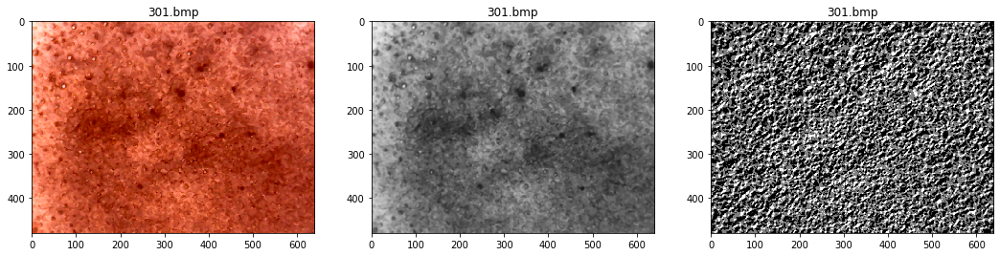

In [12]:
images, imagesNames = loadImagesAsOpencv("../Dataset1_simple/Complete")

for image, name in zip(images, imagesNames) :
    
    grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    blurred = cv2.GaussianBlur(grayImage, (3,3), 0);
    sobelX = cv2.Sobel(blurred, -1, 1, 0, ksize = 5)
    sobelY = cv2.Sobel(blurred, -1, 0, 1, ksize = 5)

    sobelXY = cv2.addWeighted(sobelX, 0.5, sobelY, 0.5, 0)
    #sobelYnp.arctan2(np.absolute(sobelX), np.absolute(sobelY))

    showOpenCVImages([image, blurred, sobelXY], titles = [name, name, name])

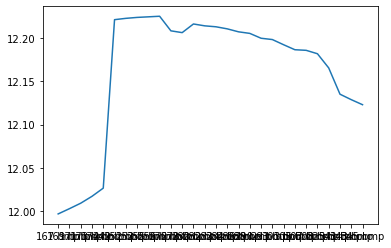

In [26]:
from scipy.stats import entropy

images1, imagesNames1 = loadImagesAsOpencv("../Dataset1_simple/foam")
images2, imagesNames2 = loadImagesAsOpencv("../Dataset1_simple/nofoam")
images = images1 + images2
imagesNames = imagesNames1 + imagesNames2
entropys = []

for image, name in zip(images, imagesNames) :
    
    grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    blurred = cv2.GaussianBlur(grayImage, (3,3), 0);
    sobelX = cv2.Sobel(blurred, -1, 1, 0, ksize = 5)
    sobelY = cv2.Sobel(blurred, -1, 0, 1, ksize = 5)

    sobelXY = cv2.addWeighted(sobelX, 0.5, sobelY, 0.5, 0)
    entropys.append(scipy.stats.entropy(sobelXY.flatten()))
    #sobelYnp.arctan2(np.absolute(sobelX), np.absolute(sobelY))

    #showOpenCVImages([image, blurred, sobelXY], titles = [name, name, name])

plt.plot(imagesNames, entropys)

In [3]:
def getOpenCVImageColorMSE(image):
    # calculate color difference factor D: 
    # source: 基于SVM的图像分类算法与实现
    
    averageColor = np.average(image)
    averageFilter = np.full((len(image), len(image[0]), 3), averageColor)

    return np.sqrt(((image - averageFilter) ** 2).sum(axis = 2)).mean()
    

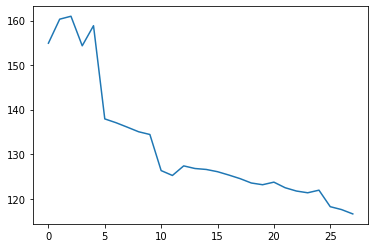

In [29]:
images1, imagesNames1 = loadImagesAsOpencv("../Dataset1_simple/foam")
images2, imagesNames2 = loadImagesAsOpencv("../Dataset1_simple/nofoam")
images = images1 + images2
imagesNames = imagesNames1 + imagesNames2

imageDValues = []

for image, name in zip(images, imagesNames) :
    
    imageDValues.append(getOpenCVImageColorMSE(image))

plt.plot(imageDValues)

In [4]:
def getNUmberofHSVColors(image):
    # source: 基于SVM的图像分类算法与实现
    
    hsvImage = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    h, s, v=cv2.split(hsvImage)
    downSampled = (h / (180/16)).astype("uint8") * 16 + (s / (255/4)).astype("uint8") * 4 + (v / (255/4)).astype("uint8")

    return len(np.unique(downSampled))

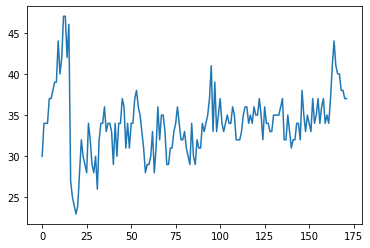

In [31]:
images1, imagesNames1 = loadImagesAsOpencv("../Dataset1/foam")
images2, imagesNames2 = loadImagesAsOpencv("../Dataset1/nofoam")
images = images1 + images2
imagesNames = imagesNames1 + imagesNames2

imageColorNumbers = []

for image in images:
    imageColorNumbers.append(getNUmberofHSVColors(image))
    
plt.plot(imageColorNumbers)

In [6]:
from scipy.stats import entropy
def getFeatures(images):
    features = []

    for image in images:
        # calculate feature 1: MSE of colors of a image
        dValue = getOpenCVImageColorMSE(image)
        #numberOfColor = getNUmberofHSVColors(image)
        
        # calculate feature 2: entropy from edges of a image
        
        # image prepocessing
        grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        blurred = cv2.GaussianBlur(grayImage, (3,3), 0);
        
        # graphic processing
        sobelX = cv2.Sobel(blurred, -1, 1, 0, ksize = 5)
        sobelY = cv2.Sobel(blurred, -1, 0, 1, ksize = 5)
        sobelXY = cv2.addWeighted(sobelX, 0.5, sobelY, 0.5, 0)
        #sobelYnp.arctan2(np.absolute(sobelX), np.absolute(sobelY))
        
        # compute entropy
        entropyValue = entropy(sobelXY.flatten())
        
        features.append([dValue, entropyValue])
    
    
    return features

In [7]:
def normalizeDataset(dataset, scaler=None):
    
    if scaler is None:
        #scaler = preprocessing.RobustScaler()
        #scaler = preprocessing.StandardScaler()
        scaler = preprocessing.MinMaxScaler()
        scaler.fit(dataset)
    #return dataset, None
    return scaler.transform(dataset), scaler

In [8]:
def train(dataset, dataTags):
    newModel = svm.LinearSVC()
    newModel.fit(dataset, dataTags)  # training the svc model 
    
    print("Train done.")
    
    return newModel

In [9]:
def predict(model, dataset):
    return model.predict(dataset)

In [10]:
def getCorrectRate(correctTags, predictedTags):
    corrects = 0
    
    assert len(correctTags) == len(predictedTags)
    for index in range(0, len(correctTags)):
        if correctTags[index] == predictedTags[index]:
            corrects += 1
    
    return int((corrects / len(correctTags)) * 10000) / 100.

In [11]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm, datasets

def make_meshgrid(x, y, h=.02):
    x_min, x_max = x.min() - 1, x.max() + 1
    y_min, y_max = y.min() - 1, y.max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))

    return xx, yy
    
def plot_contours(ax, clf, xx, yy, **params):
    """Plot the decision boundaries for a classifier.

    Parameters
    ----------
    ax: matplotlib axes object
    clf: a classifier
    xx: meshgrid ndarray
    yy: meshgrid ndarray
    params: dictionary of params to pass to contourf, optional
    """
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])

    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out   


def plotDataset(dataset, model, dataTags, dataNames):
    fig, ax = plt.subplots()

    X0, X1 = dataset[:, 0], dataset[:, 1]
    xx, yy = make_meshgrid(X0, X1)

    
    
    plot_contours(ax, model, xx, yy, cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=dataTags, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
    
    for index in range(0, len(dataset)): 
        data = dataset[index]
        dataName = dataNames[index]
                       
        ax.annotate("", xy=(data[0], data[1]), textcoords='data') # <--"""

    """
    for index in range(0, len(dataset)):
        plot_contours(ax, clf, xx, yy, cmap=plt.cm.coolwarm, alpha=0.8)
        
        if dataTags[index] == 0:
            plt.plot(dataset[index][0], dataset[index][1], "r.")
        else:
            plt.plot(dataset[index][0], dataset[index][1], "b.")
            
    for index in range(0, len(dataset)): 
        data = dataset[index]
        dataName = dataNames[index]
                       
        ax.annotate(dataName, xy=(data[0], data[1]), textcoords='data') # <--"""
    
    plt.show()

Train done.
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1] [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


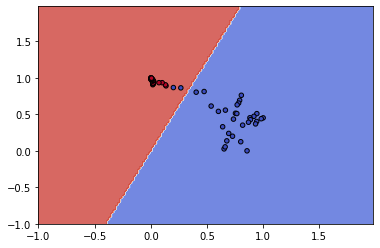

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1]
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


In [57]:
from scipy.stats import entropy
def getFeatures(images):
    features = []

    for image in images:
        # calculate feature 1: MSE of colors of a image
        dValue = getOpenCVImageColorMSE(image)
        #numberOfColor = getNUmberofHSVColors(image)
        
        # calculate feature 2: entropy from edges of a image
        
        # image prepocessing
        grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        blurred = cv2.GaussianBlur(grayImage, (3,3), 0);
        
        # graphic processing
        sobelX = cv2.Sobel(blurred, -1, 1, 0, ksize = 5)
        sobelY = cv2.Sobel(blurred, -1, 0, 1, ksize = 5)
        sobelXY = cv2.addWeighted(sobelX, 0.5, sobelY, 0.5, 0)
        #sobelYnp.arctan2(np.absolute(sobelX), np.absolute(sobelY))
        
        # compute entropy
        entropyValue = entropy(sobelXY.flatten())
        
        features.append([dValue, entropyValue])
    
    
    return features

images0, _ = loadImagesAsOpencv("../datasets/ice1/ice")
images1, _ = loadImagesAsOpencv("../datasets/ice1/noice")
dataset = getFeatures(images0)
dataset += getFeatures(images1)

dataClasses = [0 for i in range(len(images0))]
dataClasses += [1 for i in range(len(images1))]


dataset, scaler = normalizeDataset(dataset)
model = train(dataset, dataClasses)
predicted = predict(model, dataset)
print(dataClasses, predicted)
plotDataset(dataset, model, dataClasses, ["" for n in range(len(dataset))])
#plotDataset(normalizedDataset, dataClasses, imageFileNames)
#print(str(getCorrectRate(dataClasses, predicted)) + "%")

dataset0 = getFeatures(images0)
dataset0, _ = normalizeDataset(dataset0, scaler)

dataset1 = getFeatures(images1)
dataset1, _ = normalizeDataset(dataset1, scaler)

predictedTest0 = predict(model, dataset0)
print(predictedTest0)

predictedTest1 = predict(model, dataset1)
print(predictedTest1)

In [55]:
images2, _ = loadImagesAsOpencv("../datasets/foam2")
#images3, _ = [], [] #loadImagesAsOpencv("../datasets/foam2")

dataset2 = getFeatures(images2)
dataset2, _ = normalizeDataset(dataset2, scaler)

#dataset3 = getFeatures(images3)
#dataset3, _ = normalizeDataset(dataset3, scaler)

predictedTest2 = predict(model, dataset2)
print(predictedTest2)

#predictedTest3 = predict(model, dataset3)
#print(predictedTest3)

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


In [58]:
# ICE CUBE EXPERIMENTS

datasource = "../datasets/Ice2"
datasource0 = datasource + "/ice"
datasource1 = datasource + "/noice"
datasourceall = datasource + "/complete"

"""
datasource = "../Dataset1"
datasource0 = datasource + "/foam"
datasource1 = datasource + "/nofoam"
datasourceall = datasource + "/complete"
"""

'\ndatasource = "../Dataset1"\ndatasource0 = datasource + "/foam"\ndatasource1 = datasource + "/nofoam"\ndatasourceall = datasource + "/complete"\n'

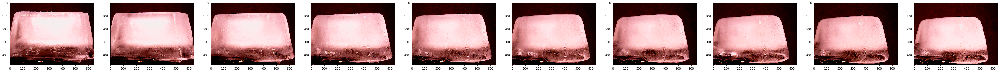

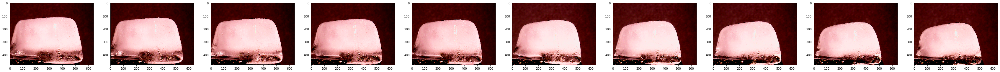

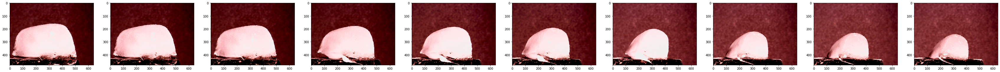

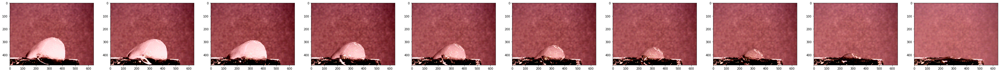

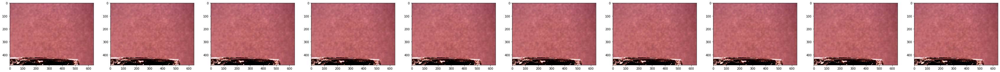

In [29]:
NUMBER_IMAGE_PER_ROW = 10

images, imagesNames = loadImagesAsOpencv(datasourceall)

counter = 0
cache = []

for image in images:
    cache.append(image)
    counter +=1
    
    if counter % NUMBER_IMAGE_PER_ROW == 0:
        showOpenCVImages(cache, titles = ["" for i in range (len(cache))])
        
        counter = 0
        cache = []

if len(images) % NUMBER_IMAGE_PER_ROW != 0:
    showOpenCVImages(cache, titles = ["" for i in range (len(cache))])

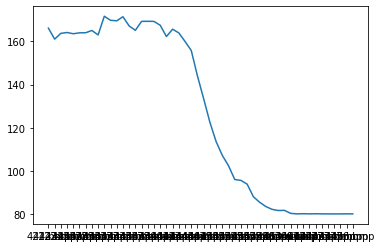

In [30]:
def getOpenCVImageColorMSE(image):
    # calculate color difference factor D: 
    # source: 基于SVM的图像分类算法与实现
    
    averageColor = np.average(image)
    averageFilter = np.full((len(image), len(image[0]), 3), averageColor)

    return np.sqrt(((image - averageFilter) ** 2).sum(axis = 2)).mean()
    
    
images, imagesNames = loadImagesAsOpencv(datasourceall)

imageDValues = []

for image, name in zip(images, imagesNames) :
    
    imageDValues.append(getOpenCVImageColorMSE(image))

plt.plot(imagesNames, imageDValues)

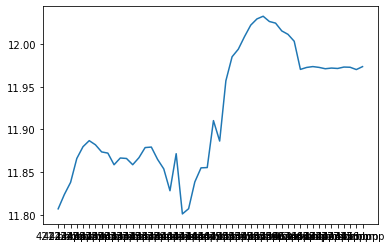

In [15]:
from scipy.stats import entropy

images, imagesNames = loadImagesAsOpencv(datasourceall)
entropys = []

for image, name in zip(images, imagesNames) :
    
    grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    blurred = cv2.GaussianBlur(grayImage, (3,3), 0);
    sobelX = cv2.Sobel(blurred, -1, 1, 0, ksize = 5)
    sobelY = cv2.Sobel(blurred, -1, 0, 1, ksize = 5)

    sobelXY = cv2.addWeighted(sobelX, 0.5, sobelY, 0.5, 0)
    entropys.append(scipy.stats.entropy(sobelXY.flatten()))
    #sobelYnp.arctan2(np.absolute(sobelX), np.absolute(sobelY))

    #showOpenCVImages([image, blurred, sobelXY], titles = [name, name, name])

plt.plot(imagesNames, entropys)

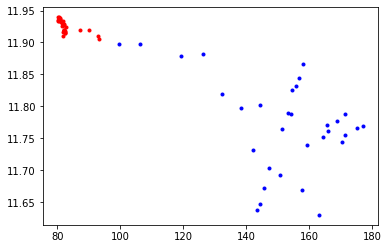

In [52]:
imagesIce, _ = loadImagesAsOpencv(datasource0)
imagesNoIce, _ = loadImagesAsOpencv(datasource1)

featuresIce = getFeatures(imagesIce)
featuresNoIce = getFeatures(imagesNoIce)

for feature in featuresIce:
    plt.plot(feature[0], feature[1], 'b.')
for feature in featuresNoIce:
    plt.plot(feature[0], feature[1], 'r.')

In [59]:
images, imagesNames = loadImagesAsOpencv(datasource0)
dataClasseIce = [0 for i in range(len(images)) ]

features = getFeatures(images)
dataset, _ = normalizeDataset(features, scaler)

prediction = predict(model, dataset)
print(prediction, len(prediction))

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1
 1] 38


In [60]:
images, imagesNames = loadImagesAsOpencv(datasource1)

features = getFeatures(images)
dataset, _ = normalizeDataset(features, scaler)

prediction = predict(model, dataset)
print(prediction, len(prediction))

[1 1 1 1 1 1 1 1 1 1 1 1 1] 13


In [63]:
(30+35)/(32+35)

0.9701492537313433

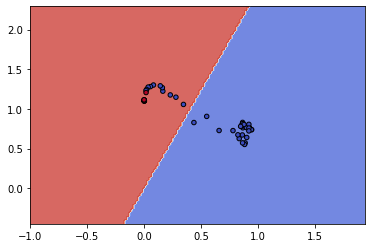

In [62]:
imagesIce, _ = loadImagesAsOpencv(datasource0)
imagesNoIce, _ = loadImagesAsOpencv(datasource1)

dataClasseIce = [0 for i in range(len(imagesIce)) ]
dataClasseIce += [1 for i in range(len(imagesNoIce)) ]

features = getFeatures(imagesIce + imagesNoIce)
dataset, _ = normalizeDataset(features, scaler)

plotDataset(dataset, model, dataClasseIce, ["" for n in range(len(dataset))])

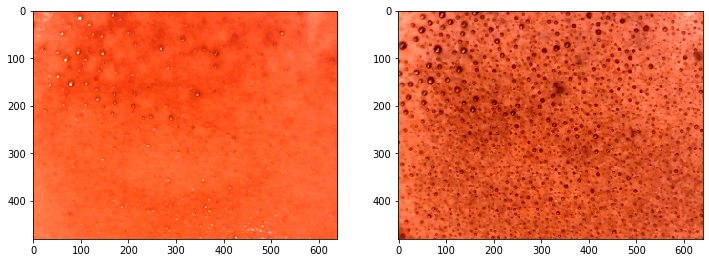

In [56]:
images, imagesNames = loadImagesAsOpencv("../Materials/dramatic change dataset1 simple")

counter = 0
cache = []

for image in images:
    cache.append(image)
    counter +=1
    
    if counter %5 == 0:
        showOpenCVImages(cache, titles = ["" for i in range (len(cache))])
        
        counter = 0
        cache = []

if len(images) %5 != 0:
    showOpenCVImages(cache, titles = ["" for i in range (len(cache))])

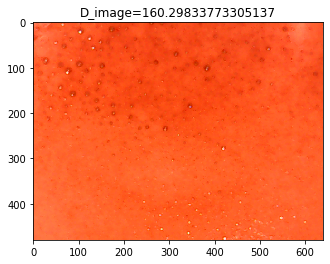

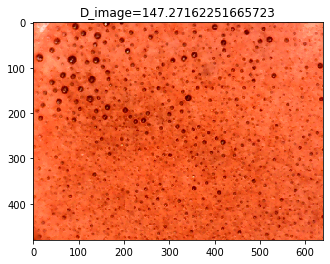

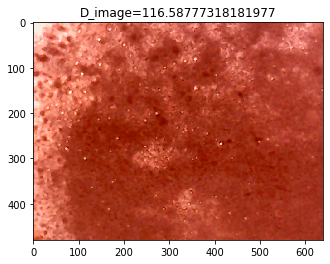

In [73]:
image1 = cv2.imread("../dataset1/complete/169.bmp")
image2 = cv2.imread("../dataset1/complete/221.bmp")
image3 = cv2.imread("../dataset1/complete/345.bmp")

showOpenCVImages([image1], titles=["D_image="+str(getOpenCVImageColorMSE(image1))])
showOpenCVImages([image2], titles=["D_image="+str(getOpenCVImageColorMSE(image2))])
showOpenCVImages([image3], titles=["D_image="+str(getOpenCVImageColorMSE(image3))])


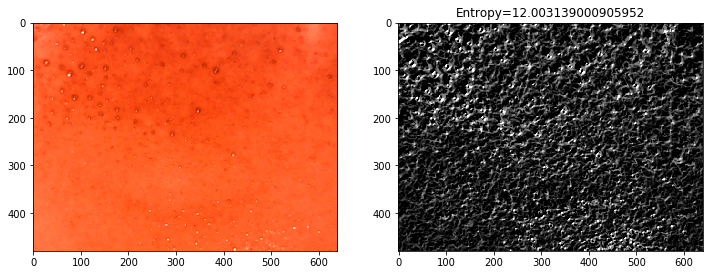

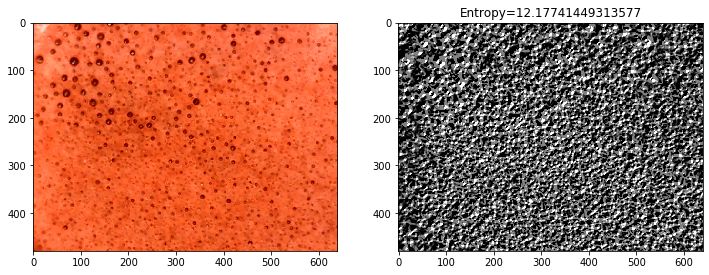

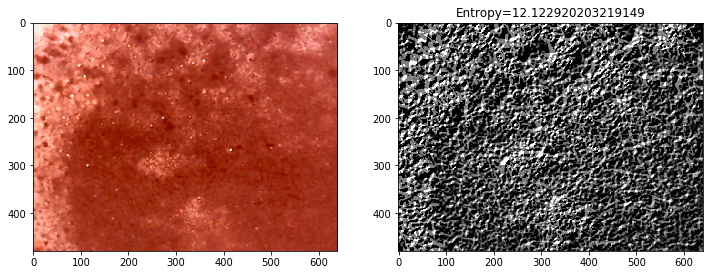

In [75]:
image1 = cv2.imread("../dataset1/complete/169.bmp")
image2 = cv2.imread("../dataset1/complete/221.bmp")
image3 = cv2.imread("../dataset1/complete/345.bmp")

images= [image1, image2, image3]


for image in images:
    
    grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    blurred = cv2.GaussianBlur(grayImage, (3,3), 0);
    sobelX = cv2.Sobel(blurred, -1, 1, 0, ksize = 5)
    sobelY = cv2.Sobel(blurred, -1, 0, 1, ksize = 5)

    sobelXY = cv2.addWeighted(sobelX, 0.5, sobelY, 0.5, 0)
    #sobelYnp.arctan2(np.absolute(sobelX), np.absolute(sobelY))

    showOpenCVImages([image, sobelXY], titles = ["", "Entropy="+str(scipy.stats.entropy(sobelXY.flatten()))])